# Gradient Experiments

This notebook contains various experiments concerning the idea of using gradients as an input feature for testfunction simulation.
Note that some (more or less promising) approaches are revisited and evaluated in the f1, f3, and f24 simulation notebooks.

In [7]:
import sys
sys.path.append("..")
sys.path.append("../main")

import matplotlib.pyplot as plt
import numpy as np
import torch
import bbobtorch
import torch
import model
from utils import gt_sampling
import torch.optim as optim
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from copy import deepcopy
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
from utils.utils import plot_simulated_meshgrid, plot_collage, plot_ground_truth

In [8]:
# create ground truth functions
n_dim = 2
samples = 1000
seed = 42

def create_problem(f_number, n_dim, seed):
    if f_number == 1:
        problem = bbobtorch.create_f01(n_dim, seed=seed)
    elif f_number == 3:
        problem = bbobtorch.create_f03(n_dim, seed=seed)
    elif f_number == 24:
        problem = bbobtorch.create_f24(n_dim, seed=seed)

    return problem

problem_f01 = create_problem(1, n_dim, seed)
problem_f03 = create_problem(3, n_dim, seed)
problem_f24 = create_problem(24, n_dim, seed)

In [9]:
# sampling from groundtruth functions
sample_f01 = gt_sampling.get_sample(problem_f01, n_samples=samples, n_dim=2, seed=42, method='random')
sample_f03 = gt_sampling.get_sample(problem_f03, n_samples=samples, n_dim=2, seed=42, method='random')
sample_f24 = gt_sampling.get_sample(problem_f24, n_samples=samples, n_dim=2, seed=42, method='random')

c:\Users\schla\OptimizationTestfunctionGeneration\main\..\utils\gt_sampling.py:82: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  tensor_sample = torch.tensor(result[i], dtype=torch.float64).reshape((1, n_dim)).float()


In [10]:
data = sample_f24
problem = problem_f24

# input with only normal input features x1 and x2
X_input = torch.tensor(data[0], dtype=torch.float32).clone().detach()

# input with normal input features and first order gradients
X_input_grad1 = torch.tensor(np.concatenate((X_input, data[2]), axis=1), dtype=torch.float32).clone().detach()

# input with normal input features and first and second order gradients
X_input_grad2 = torch.tensor(np.concatenate((X_input, data[2], data[3]), axis=1), dtype=torch.float32).clone().detach()

# target values
y_input = data[1].float()            

C:\Users\schla\AppData\Local\Temp\ipykernel_27708\1921756243.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_input = torch.tensor(data[0], dtype=torch.float32).clone().detach()


## SVM with gradients as input feature
Train SVM with and without gradient information as input

In [11]:
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('model', SVR(kernel='rbf', C=10, gamma=0.6)),
])

In [12]:
svr1 = deepcopy(pipe)
svr2 = deepcopy(pipe)
svr3 = deepcopy(pipe)

In [13]:
svr1.fit(X_input, y_input)
svr2.fit(X_input_grad1, y_input)
svr3.fit(X_input_grad2, y_input);

In [14]:
x = np.linspace(-5.0, 5.0, 1000)
y = np.linspace(-5.0, 5.0, 1000)
X, Y = np.meshgrid(x, y)

gradients_x = np.zeros_like(X)
gradients_y = np.zeros_like(Y)

gradients2_x = np.zeros_like(X)
gradients2_y = np.zeros_like(Y)

# Iterate through each point in the mesh grid and compute gradients
for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        gradients_x[i, j], gradients_y[i, j] = gt_sampling.get_gradient(problem, torch.tensor(np.array([X[i, j], Y[i, j]]).reshape((1, 2)), dtype=torch.float32))
        gradients2_x[i, j], gradients2_y[i, j] = gt_sampling.get_second_derivative(problem, torch.tensor(np.array([X[i, j], Y[i, j]]).reshape((1, 2)), dtype=torch.float32))
        
mesh_samples = np.c_[X.ravel(), Y.ravel(), gradients_x.ravel(), gradients_y.ravel(), gradients2_x.ravel(), gradients2_y.ravel()]
mesh_samples_tensor = torch.tensor(mesh_samples, dtype=torch.float32)
mesh_results1 = svr1.predict(mesh_samples_tensor[:, 0:2]).reshape(X.shape)
mesh_results2 = svr2.predict(mesh_samples_tensor[:, 0:4]).reshape(X.shape)
mesh_results3 = svr3.predict(mesh_samples_tensor).reshape(X.shape)

c:\ProgramData\Anaconda3\envs\python-3-10-env\MachineLearningProjectTest\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


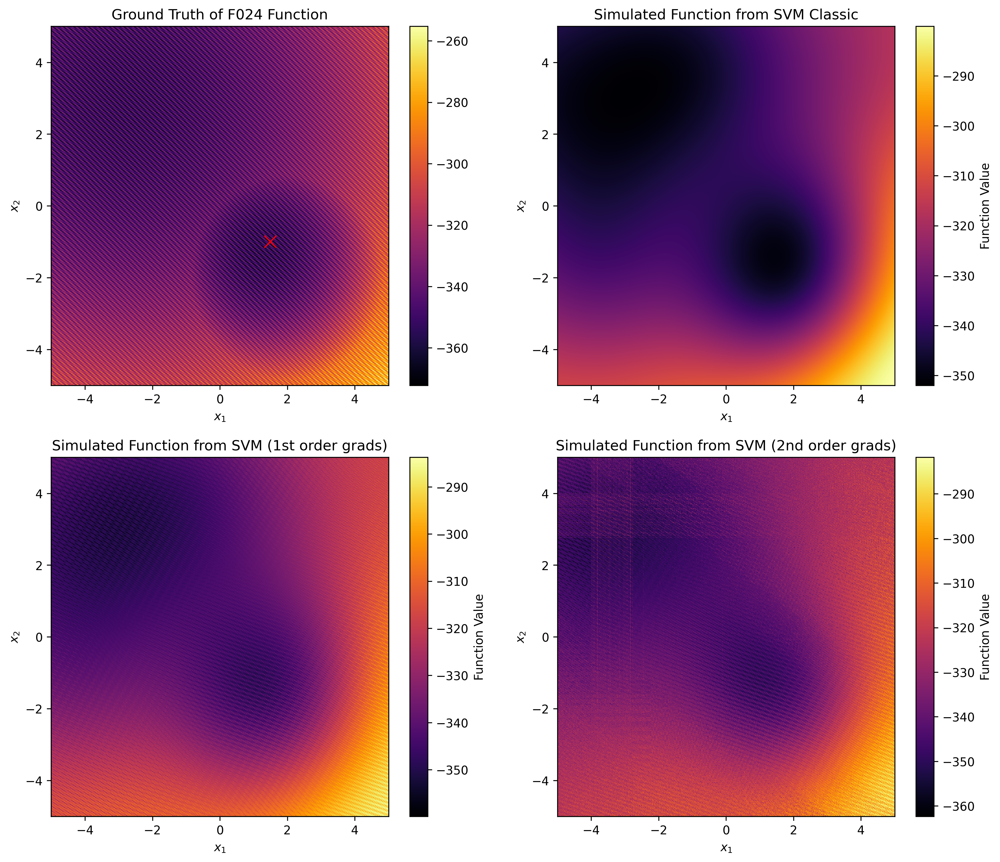

In [15]:
plt.subplot(221)
plot_ground_truth(n_dim, problem, "F024")
plt.subplot(222)
plot_simulated_meshgrid(X, Y, mesh_results1, model='SVM Classic')
plt.subplot(223)
plot_simulated_meshgrid(X, Y, mesh_results2, model='SVM (1st order grads)')
plt.subplot(224)
plot_simulated_meshgrid(X, Y, mesh_results3, model='SVM (2nd order grads)')
plt.gcf().set_size_inches(14, 12)
plt.gcf().set_dpi(300)
plt.show()

--> promising results with SVM when using gradients as an input feature
--> BUT: problem: gradients obtained from the groundtruth have been used to generate the graphics above and would have to be used when benchmarking an optimizer on the testfunction
--> this scenario (having gradients of the groundtruth available but not the real values (why we use a testfunction)) is not very realistic
--> alternatives need to be tested (see below)

## SVM with masked gradients
IDEA: mask a specific share of the gradients during training (with 0s or mean value), use an array of only the masking value during inference

In [16]:
X_input_grad1_m = deepcopy(X_input_grad1)
X_input_grad2_m = deepcopy(X_input_grad2)

In [17]:
# replace XX% of the data randomly with 0 in X_input_grad1
percentage = 0.5
np.random.seed(seed)
X_input_grad1_m[np.random.choice(X_input.shape[0], int(X_input.shape[0]*percentage), replace=False), 2] = 0 #X_input_grad1_m[:,2].mean()
np.random.seed(seed+1)
X_input_grad1_m[np.random.choice(X_input.shape[0], int(X_input.shape[0]*percentage), replace=False), 3] = 0 #XX_input_grad1_m[:,3].mean()

np.random.seed(seed)
X_input_grad2_m[np.random.choice(X_input.shape[0], int(X_input.shape[0]*percentage), replace=False), 2] = 0 #XX_input_grad2_m[:,2].mean()
np.random.seed(seed+1)
X_input_grad2_m[np.random.choice(X_input.shape[0], int(X_input.shape[0]*percentage), replace=False), 3] = 0 #XX_input_grad2_m[:,3].mean()
np.random.seed(seed+2)
X_input_grad2_m[np.random.choice(X_input.shape[0], int(X_input.shape[0]*percentage), replace=False), 4] = 0 #XX_input_grad2_m[:,4].mean()
np.random.seed(seed+3)
X_input_grad2_m[np.random.choice(X_input.shape[0], int(X_input.shape[0]*percentage), replace=False), 5] = 0 #XX_input_grad2_m[:,5].mean()

In [18]:
svr1 = deepcopy(pipe)
svr2 = deepcopy(pipe)
svr3 = deepcopy(pipe)

In [19]:
svr1.fit(X_input, y_input)
svr2.fit(X_input_grad1_m, y_input)
svr3.fit(X_input_grad2_m, y_input);

In [20]:
x = np.linspace(-5.0, 5.0, 100)
y = np.linspace(-5.0, 5.0, 100)
X, Y = np.meshgrid(x, y)

gradients_x = np.zeros_like(X) # np.ones_like(X)*X_input_grad1[:,2].mean().item()
gradients_y = np.zeros_like(Y) # np.ones_like(Y)*X_input_grad1[:,3].mean().item()

gradients2_x = np.zeros_like(X) # np.ones_like(X)*X_input_grad2[:,4].mean().item()
gradients2_y = np.zeros_like(Y) # np.ones_like(X)*X_input_grad2[:,5].mean().item()

# # Iterate through each point in the mesh grid and compute gradients
# for i in range(X.shape[0]):
#     for j in range(X.shape[1]):
#         gradients_x[i, j], gradients_y[i, j] = gt_sampling.get_gradient(problem, torch.tensor(np.array([X[i, j], Y[i, j]]).reshape((1, 2)), dtype=torch.float32))
#         gradients2_x[i, j], gradients2_y[i, j] = gt_sampling.get_second_derivative(problem, torch.tensor(np.array([X[i, j], Y[i, j]]).reshape((1, 2)), dtype=torch.float32))
        
mesh_samples = np.c_[X.ravel(), Y.ravel(), gradients_x.ravel(), gradients_y.ravel(), gradients2_x.ravel(), gradients2_y.ravel()]
mesh_samples_tensor = torch.tensor(mesh_samples, dtype=torch.float32)
mesh_results1 = svr1.predict(mesh_samples_tensor[:, 0:2]).reshape(X.shape)
mesh_results2 = svr2.predict(mesh_samples_tensor[:, 0:4]).reshape(X.shape)
mesh_results3 = svr3.predict(mesh_samples_tensor).reshape(X.shape)

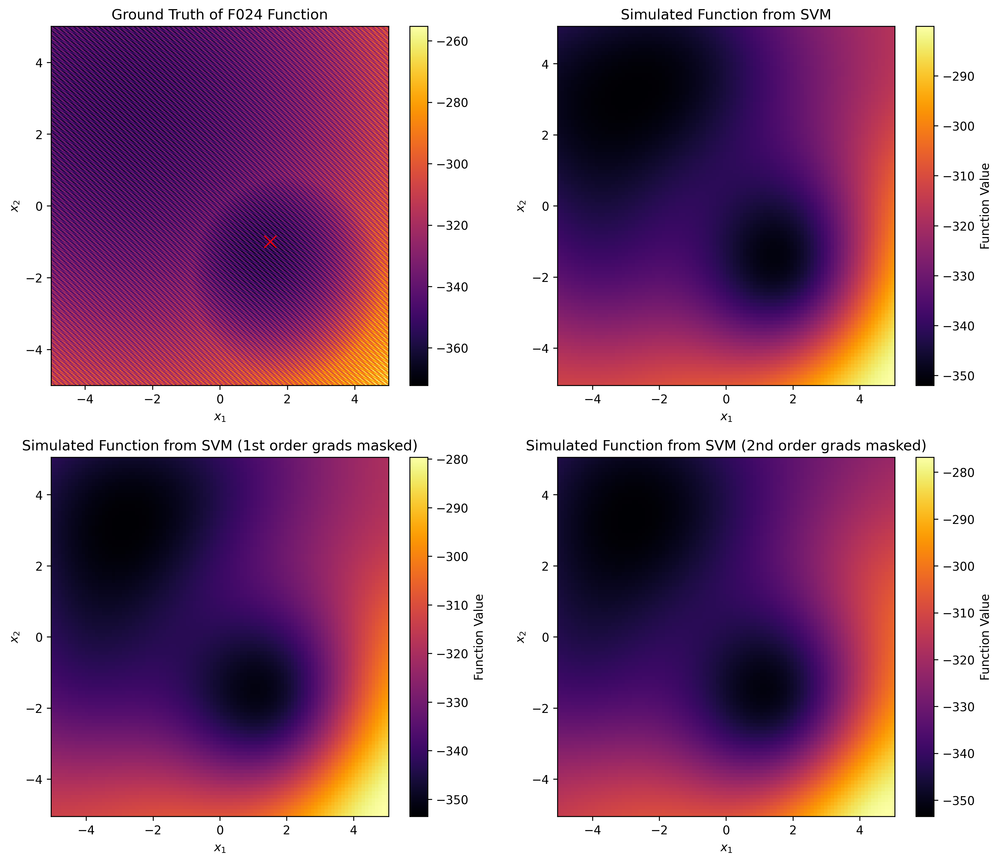

In [21]:
plt.subplot(221)
plot_ground_truth(n_dim, problem, "F024")
plt.subplot(222)
plot_simulated_meshgrid(X, Y, mesh_results1, model='SVM')
plt.subplot(223)
plot_simulated_meshgrid(X, Y, mesh_results2, model='SVM (1st order grads masked)')
plt.subplot(224)
plot_simulated_meshgrid(X, Y, mesh_results3, model='SVM (2nd order grads masked)')
plt.gcf().set_size_inches(14, 12)
plt.gcf().set_dpi(300)
plt.show()

--> masking gradients seems not to be a good approach and will therefore not be tested further or evaluated with optimizers (note that we also tried different masking percentages or using the mean as mask)

## SVM with gradient estimation

IDEA: use real gradients for training and estimated gradients during inference

### Simple estimation with nearest neighbor from training data

IDEA 1: use the gradients of the nearest neighboring point in the training sample as estimation

In [22]:
def euclidean_distance(point1, point2):
    return np.sqrt(np.sum((np.array(point1) - np.array(point2)) ** 2))

def nearest_point(x1, x2, point_set):
    min_distance = float('inf')
    nearest_point = None
    
    for point in point_set:
        distance = euclidean_distance([x1, x2], point)	
        if distance < min_distance:
            min_distance = distance
            nearest_point = point
    
    return nearest_point

def nearest_point_with_target(x1, x2, point_set, target):
    min_distance = float('inf')
    nearest_point = None
    target_value = None
    
    for point, target_val in zip(point_set, target):
        distance = euclidean_distance([x1, x2], point)	
        if distance < min_distance:
            min_distance = distance
            nearest_point = point
            target_value = target_val
    
    return nearest_point, target_value

In [23]:
data = sample_f24
problem = problem_f24
X_input = torch.tensor(data[0], dtype=torch.float32).clone().detach()
X_input_grad1 = torch.tensor(np.concatenate((X_input, data[2]), axis=1), dtype=torch.float32).clone().detach()
X_input_grad2 = torch.tensor(np.concatenate((X_input, data[2], data[3]), axis=1), dtype=torch.float32).clone().detach()
y_input = data[1].float()   

C:\Users\schla\AppData\Local\Temp\ipykernel_27708\1105536199.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_input = torch.tensor(data[0], dtype=torch.float32).clone().detach()


In [24]:
svr1.fit(X_input, y_input)
svr2.fit(X_input_grad1, y_input)
svr3.fit(X_input_grad2, y_input);

In [25]:
x = np.linspace(-5.0, 5.0, 100)
y = np.linspace(-5.0, 5.0, 100)
X, Y = np.meshgrid(x, y)

gradients_x = np.zeros_like(X)
gradients_y = np.zeros_like(Y)

gradients2_x = np.zeros_like(X)
gradients2_y = np.zeros_like(Y)

# Iterate through each point in the mesh grid and estimate gradients
for i in tqdm(range(X.shape[0])):
    for j in range(X.shape[1]):
        gradients_x[i, j], gradients_y[i, j] = nearest_point_with_target(X[i, j], Y[i, j], X_input_grad1[:, 0:2], X_input_grad1[:, 2:4])[1]
        
mesh_samples = np.c_[X.ravel(), Y.ravel(), gradients_x.ravel(), gradients_y.ravel()] 
mesh_samples_tensor = torch.tensor(mesh_samples, dtype=torch.float32)
mesh_results1 = svr1.predict(mesh_samples_tensor[:, 0:2]).reshape(X.shape)
mesh_results2 = svr2.predict(mesh_samples_tensor[:, 0:4]).reshape(X.shape)

100%|██████████| 100/100 [03:30<00:00,  2.11s/it]


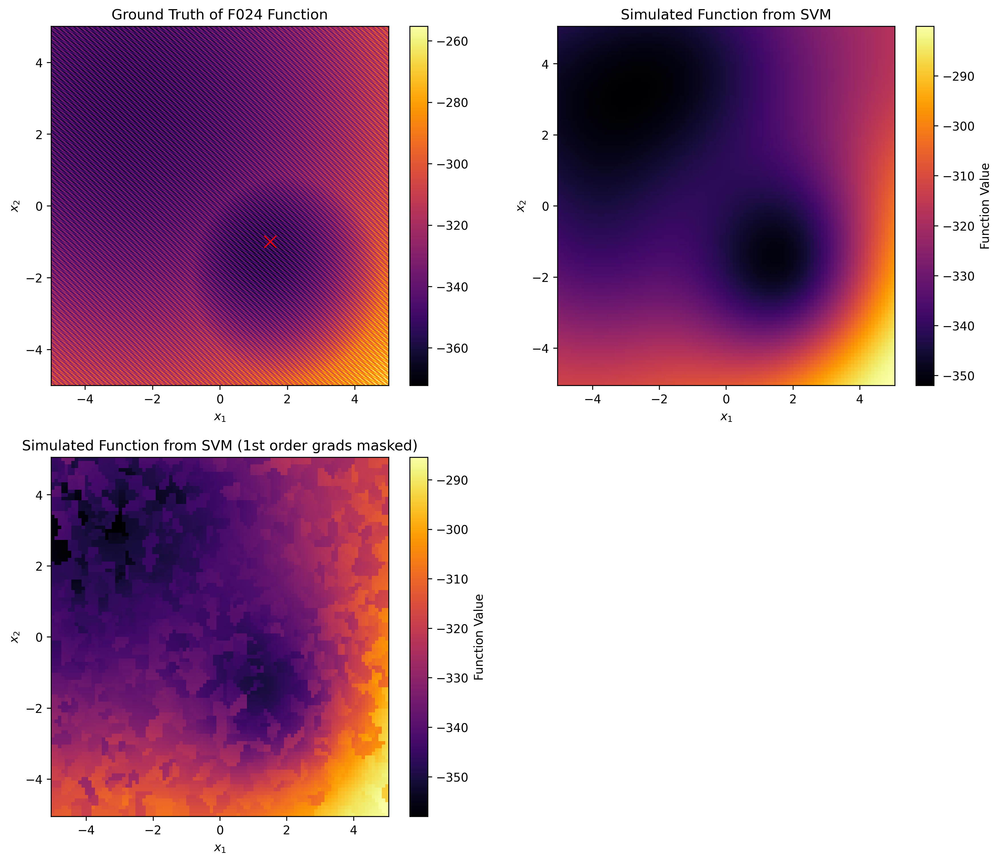

In [26]:
plt.subplot(221)
plot_ground_truth(n_dim, problem, "F024")
plt.subplot(222)
plot_simulated_meshgrid(X, Y, mesh_results1, model='SVM')
plt.subplot(223)
plot_simulated_meshgrid(X, Y, mesh_results2, model='SVM (1st order grads masked)')
plt.gcf().set_size_inches(14, 12)
plt.gcf().set_dpi(300)
plt.show()

### Gradient estimation with Machine Learning

IDEA 2: train a machine learning model (here: gaussian process regressor) to predict gradients and use the predicted gradients as input feature during inference

In [27]:
gradient_estimator = MultiOutputRegressor(GaussianProcessRegressor())

In [28]:
gradient_estimator.fit(X_input_grad1[:,0:2], X_input_grad1[:,2:4])

MultiOutputRegressor(estimator=GaussianProcessRegressor())

In [29]:
x = np.linspace(-5.0, 5.0, 100)
y = np.linspace(-5.0, 5.0, 100)
X, Y = np.meshgrid(x, y)

gradients_x = np.zeros_like(X)
gradients_y = np.zeros_like(Y)

gradients2_x = np.zeros_like(X)
gradients2_y = np.zeros_like(Y)

# Iterate through each point in the mesh grid and estimate gradients
for i in tqdm(range(X.shape[0])):
    for j in range(X.shape[1]):
        gradients_x[i, j], gradients_y[i, j] = gradient_estimator.predict([[X[i, j], Y[i, j]]])[0]
        
mesh_samples = np.c_[X.ravel(), Y.ravel(), gradients_x.ravel(), gradients_y.ravel()] 
mesh_samples_tensor = torch.tensor(mesh_samples, dtype=torch.float32)
mesh_results1 = svr1.predict(mesh_samples_tensor[:, 0:2]).reshape(X.shape)
mesh_results2 = svr2.predict(mesh_samples_tensor[:, 0:4]).reshape(X.shape)

100%|██████████| 100/100 [00:09<00:00, 10.77it/s]


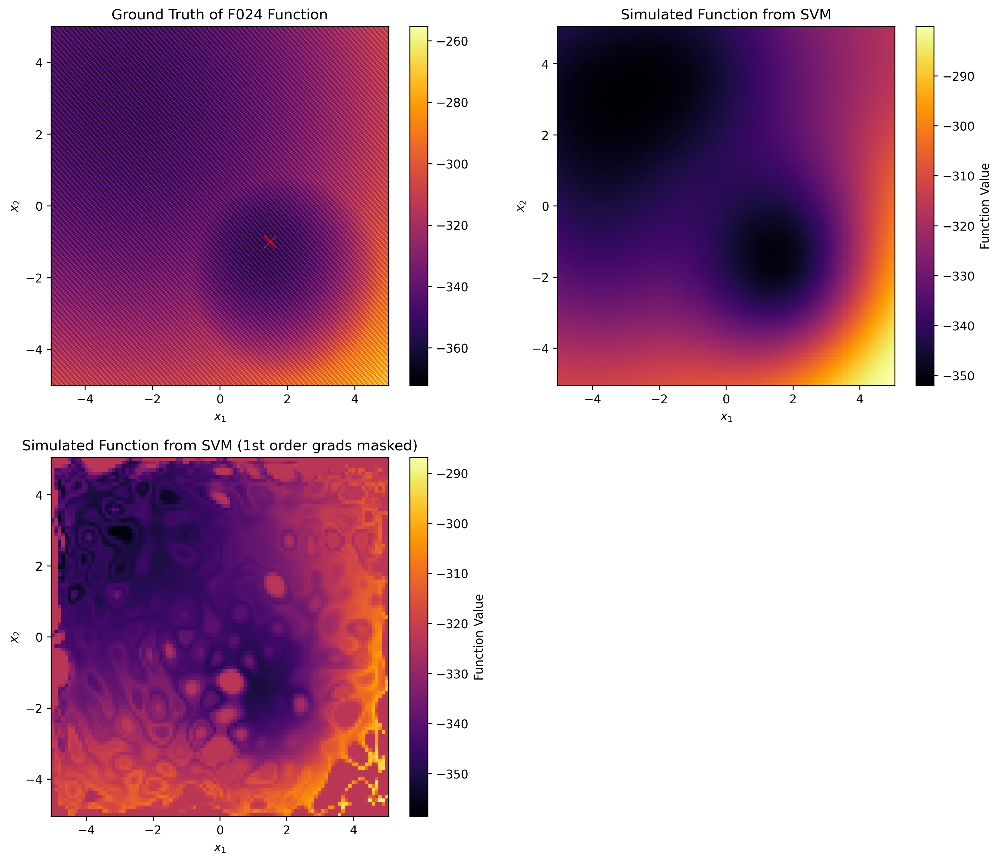

In [30]:
plt.subplot(221)
plot_ground_truth(n_dim, problem, "F024")
plt.subplot(222)
plot_simulated_meshgrid(X, Y, mesh_results1, model='SVM')
plt.subplot(223)
plot_simulated_meshgrid(X, Y, mesh_results2, model='SVM (1st order grads masked)')
plt.gcf().set_size_inches(14, 12)
plt.gcf().set_dpi(300)
plt.show()

--> even though both gradient estimation approaches are not satisfying, they will be further evaluated (see f1, f3, and f24 simulation notebooks for results)